This workbook serves as a quick way to check and remake the benchmark point(s) for the LHCHXSWG WG3.

In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from itertools import izip

# to show plots:
get_ipython().magic(u'pylab inline')

get_ipython().magic(u'load_ext autoreload')
get_ipython().magic(u'autoreload 2')

get_ipython().magic(u"config InlineBackend.figure_formats = 'png', ")

mpl.rcParams['figure.figsize'] = (7.0, 4.0)  # default size of plots
mpl.rcParams['axes.labelsize'] = 30
mpl.rcParams['xtick.labelsize'] = 20
mpl.rcParams['ytick.labelsize'] = 20
mpl.rcParams['xtick.major.size'] = 10
mpl.rcParams['ytick.major.size'] = 10
mpl.rcParams['xtick.minor.size'] = 5
mpl.rcParams['ytick.minor.size'] = 5
mpl.rcParams['legend.framealpha'] = 0.6
mpl.rcParams['legend.scatterpoints'] = 1
mpl.rcParams.update({'font.size': 24, 'font.family': 'STIXGeneral', 'mathtext.fontset': 'stix'})


Populating the interactive namespace from numpy and matplotlib


In [2]:
from common_plots import *

In [3]:
# Some common Upsilon masses and widths
upsilon_masses = [9.460, 10.023, 10.355] # GeV
upsilon_width = [5.402E-5, 3.198E-5, 3.315E-4] # GeV - in reality I shoudl probably use the experimenal resolution here
# The range covering all bbbar resonances from eta_b(1S) to upsilon(11020), in GeV:
resonance_min, resonance_max = 9.398, 11.019 

def draw_res_lines():
    for i, m in enumerate(upsilon_masses):
        label = r'$\Upsilon(1S/2S/3S)$' if i == 0 else ""
        plt.axvline(x=m, label=label, ls='-', color='fuchsia', lw=2)


In [4]:
# The 8Tev expected and observed limits for overlay
# NOT A PUBLIC REUSLT YET
cms_masses = [4, 5, 6, 7, 8]
cms_expected = [10.6, 10.3, 5.4, 3.1, 2.9]
cms_obs = [7.1, 10.3, 8.6, 5.0, 4.5]

def draw_cms_lines():
    plt.plot(cms_masses, cms_obs, color='black', lw=3, label=r"CMS $4\tau$ obs. limit")
    plt.plot(cms_masses, cms_expected, color='red', lw=3, label=r'CMS $4\tau$ expec. limit', linestyle='dashed')

In [5]:
# Extract dataframes from binary
store = pd.HDFStore("points_I42_scan_ma1Lt11.h5")
df_orig = store.full12loop_all
df_pass_all = store.full12loop_good_posMuMagMom_planckUpperOnly #'relaxed' constraints - +ve g-2 and omegah^2
store.close()

In [6]:
# Make subsets based on masses, and passing ALL NMSSMTools constraints (i.e. don't ignore g-2 and relic density)
from make_hdf5 import subset_mass
df_pass_all_h1 = subset_mass(df_pass_all, 122.1, 128.1, 'mh1')
df_pass_all_h2 = subset_mass(df_pass_all, 122.1, 128.1, 'mh2')
df_pass_all_strict = df_pass_all[df_pass_all.constraints == ""]
# df_pass_all_strict_ma1Lt11 = subset_mass(df_pass_all_strict, 0, 11, 'ma1')
# print df_pass_all_strict_ma1Lt11.T

In [7]:
print 'Original points (no constraints):', len(df_orig.index) 
print 'With relaxed constraints (on g-2, relic density & some LHC constraints):', len(df_pass_all.index)
print 'Strictly enforcing all constraints in NMSSMTools 4.6.0:',len(df_pass_all_strict.index)

Original points (no constraints): 49443
With relaxed constraints (on g-2, relic density & some LHC constraints): 2864
Strictly enforcing all constraints in NMSSMTools 4.6.0: 71


Here we make our subset of benchmark candidates. We are looking for:

- pass *every* constraint in NMSSMTools

- avoid Upsilon resonances, so $m_{a_1} \lesssim 9$ GeV

- large-ish cross-section - bigger than 1 pb

- not too large a cross-section! Don't want to exclude ourselves from the 8 TeV analysis (to check, the 8 TeV corss-section is a factor $\sim 2.5$ smaller than the 13 TeV cross-section)

- prefer a slightly larger $m_{a_1}$ since experimentally this gives us a better sensitivity in the $\mu + trk$ strategy against $b\bar{b}$ QCD backgrounds

In [37]:
pd.set_option('display.max_rows', 500)
# The magic reference point:
# Criteria:
# - tighter h(125) requirements?
# - largeish xsec for 4tau
# - avoid the Upsilon resonances
# - pass every constraint in NMSSMTools
# - avoid a large Br(h1 -> a1a1)
df_ref = subset_mass(df_pass_all_strict, 122.1, 128, 'mh1')
df_ref = subset_mass(df_ref, 8, 9, 'ma1')
df_ref = subset_mass(df_ref, 0, 0.1, 'Brh1a1a1')
df_ref = df_ref[df_ref.xsec13_h1_2a1_4tau>2]
# df_ref = df_ref.loc[42772]
df_ref_labels = df_ref.index.tolist() # list of point indices for reference
print len(df_ref.index)
df_ref.T

1


,19360
mtau,1.777
mh1,123.0787
mh2,745.3214
mh3,2012.457
ma1,8.505171
ma2,2011.839
mhc,2017.93
mstop1,855.9623
mstop2,1203.012
msbottom1,1031.943


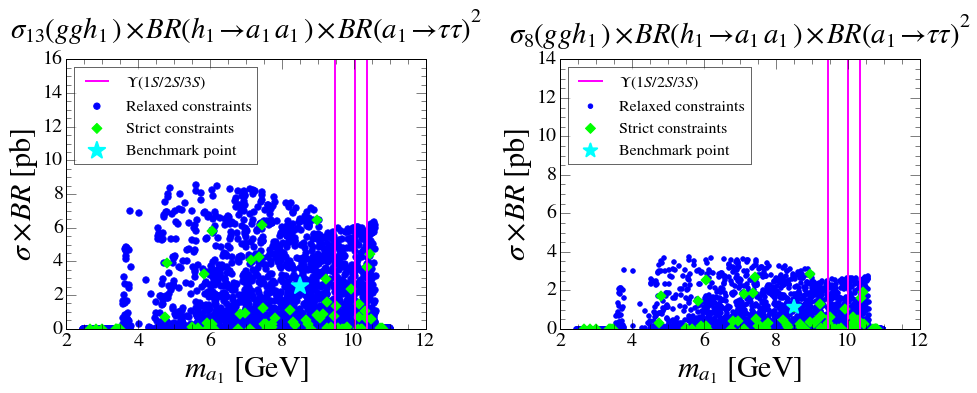

In [69]:
fig = generate_fig()
ax1 = fig.add_subplot(1,2,1)
xvar = 'ma1'
xlabel = r'$m_{a_1}\ \mathrm{[GeV]}$'
yvar = 'xsec13_h1_2a1_4tau'
ylabel = r'$\sigma\times BR\ \mathrm{[pb]}$'
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_h1, 
             color='blue', xlabel=xlabel, ylabel=ylabel, s=40, 
             label='Relaxed constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_strict, 
             color='lime', xlabel=xlabel, ylabel=ylabel, marker='D', s=50,
             label='Strict constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_ref, 
             xlabel=xlabel, ylabel=ylabel,
             label='Benchmark point', color='cyan', marker="*", s=300, lw=2)
draw_res_lines()
plt.ylim(bottom=0, top=16)
plt.xlim(right=12)
plt.legend(fontsize=16, loc=0)
ax1.set_title(r'$\sigma_{13}(ggh_1)\times BR(h_1\to a_1 a_1)\times BR(a_1\to\tau \tau)^2$', y=1.06)

ax2 = fig.add_subplot(1,2,2)
xvar = 'ma1'
xlabel = r'$m_{a_1}\ \mathrm{[GeV]}$'
yvar = 'xsec8_h1_2a1_4tau'
ylabel = r'$\sigma\times BR\ \mathrm{[pb]}$'
plot_scatter(ax2, xvar=xvar, yvar=yvar, df=df_pass_all_h1, 
             color='blue', xlabel=xlabel, ylabel=ylabel, 
             label='Relaxed constraints')
plot_scatter(ax2, xvar=xvar, yvar=yvar, df=df_pass_all_strict, 
             color='lime', xlabel=xlabel, ylabel=ylabel, s=50, marker='D',
             label='Strict constraints')
plot_scatter(ax2, xvar=xvar, yvar=yvar, df=df_ref, 
             xlabel=xlabel, ylabel=ylabel,
             label='Benchmark point', color='cyan', marker="*", s=200, lw=2)
draw_res_lines()
# draw_cms_lines()
plt.ylim(bottom=0, top=14)
plt.xlim(right=12)
plt.legend(fontsize=16, loc=0)
ax2.set_title(r'$\sigma_{8}(ggh_1)\times BR(h_1\to a_1 a_1)\times BR(a_1\to\tau \tau)^2$')
plt.tight_layout()

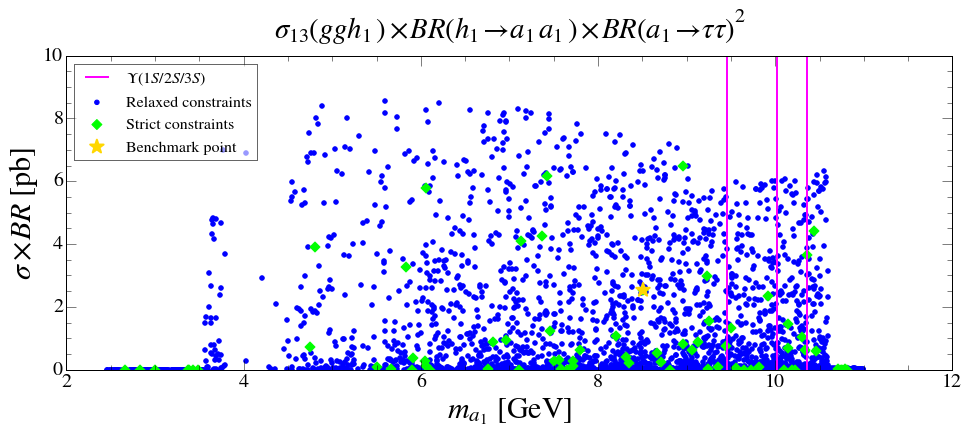

In [52]:
fig = generate_fig()
ax1 = fig.add_subplot(1,1,1)
xvar = 'ma1'
xlabel = r'$m_{a_1}\ \mathrm{[GeV]}$'
yvar = 'xsec13_h1_2a1_4tau'
ylabel = r'$\sigma\times BR\ \mathrm{[pb]}$'
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_h1, 
             color='blue', xlabel=xlabel, ylabel=ylabel, 
             label='Relaxed constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_strict, 
             color='lime', xlabel=xlabel, ylabel=ylabel, marker='D', s=50,
             label='Strict constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_ref, 
             xlabel=xlabel, ylabel=ylabel,
             label='Benchmark point', color='gold', marker="*", s=200, lw=2)
# label points with ther index in the DataFrame
# for label, x, y in zip(df_ref_labels, df_ref[xvar].values, df_ref[yvar].values):
#     plt.annotate(label, (x,y), 
#                  bbox = dict(boxstyle = 'round,pad=0.5', fc = 'yellow', alpha = 0.5), fontsize=14,
#                  textcoords = 'offset points', ha = 'right', va = 'bottom',
#                  xytext = (-20, 20),
#                  arrowprops = dict(arrowstyle = '->', connectionstyle = 'arc3,rad=0'))
draw_res_lines()
plt.ylim(bottom=0, top=10)
plt.xlim(right=12)
plt.legend(fontsize=16, loc=0)
ax1.set_title(r'$\sigma_{13}(ggh_1)\times BR(h_1\to a_1 a_1)\times BR(a_1\to\tau \tau)^2$')

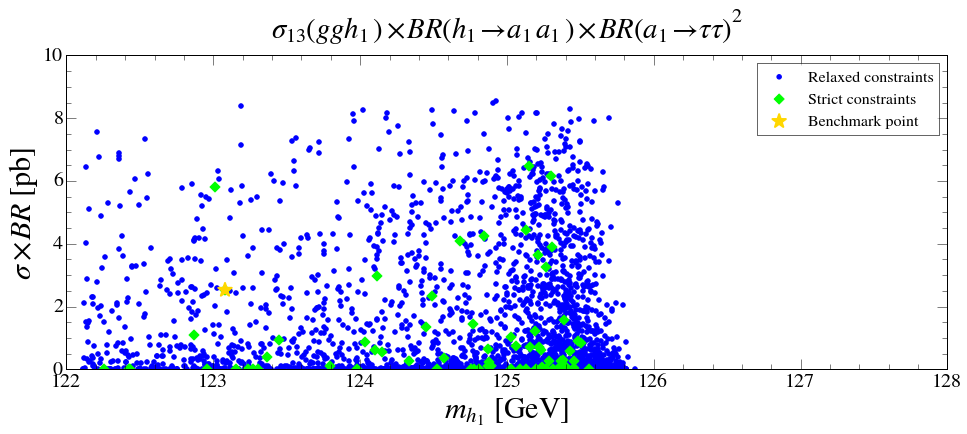

In [53]:
fig = generate_fig()
ax1 = fig.add_subplot(1,1,1)
xvar = 'mh1'
xlabel = r'$m_{h_1}\ \mathrm{[GeV]}$'
yvar = 'xsec13_h1_2a1_4tau'
ylabel = r'$\sigma\times BR\ \mathrm{[pb]}$'
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_h1, 
             color='blue', xlabel=xlabel, ylabel=ylabel, 
             label='Relaxed constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_strict, 
             color='lime', xlabel=xlabel, ylabel=ylabel, marker='D', s=50,
             label='Strict constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_ref, 
             xlabel=xlabel, ylabel=ylabel,
             label='Benchmark point', color='gold', marker="*", s=200, lw=2)
# label points with their index in the DataFrame
# for label, x, y in zip(df_ref_labels, df_ref[xvar].values, df_ref[yvar].values):
#     plt.annotate(label, (x,y), 
#                  bbox = dict(boxstyle = 'round,pad=0.5', fc = 'yellow', alpha = 0.5), fontsize=14,
#                  textcoords = 'offset points', ha = 'right', va = 'bottom',
#                  xytext = (0, 20),
#                  arrowprops = dict(arrowstyle = '->', connectionstyle = 'arc3,rad=0'))
# draw_res_lines()
plt.ylim(bottom=0, top=10)
plt.xlim(left=122, right=128)
plt.legend(fontsize=16, loc=0)
ax1.set_title(r'$\sigma_{13}(ggh_1)\times BR(h_1\to a_1 a_1)\times BR(a_1\to\tau \tau)^2$')


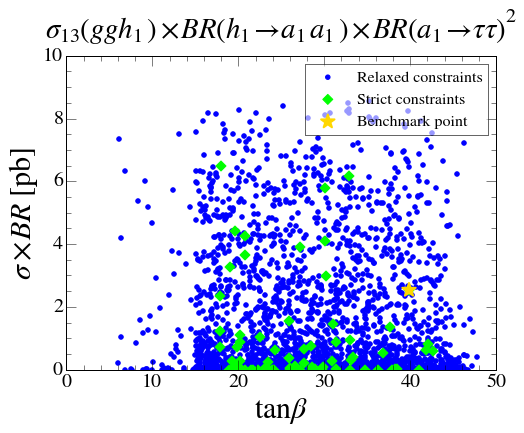

In [54]:
fig = generate_fig()
ax1 = fig.add_subplot(1,2,1)
xvar = 'tgbeta'
xlabel = r'$\tan \beta$'
yvar = 'xsec13_h1_2a1_4tau'
ylabel = r'$\sigma\times BR\ \mathrm{[pb]}$'
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_h1, 
             color='blue', xlabel=xlabel, ylabel=ylabel, 
             label='Relaxed constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_strict, 
             color='lime', xlabel=xlabel, ylabel=ylabel, marker='D', s=50,
             label='Strict constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_ref, 
             xlabel=xlabel, ylabel=ylabel,
             label='Benchmark point', color='gold', marker="*", s=200, lw=2)
plt.ylim(bottom=0, top=10)
plt.xlim(right=50)
plt.legend(fontsize=16, loc=0)
ax1.set_title(r'$\sigma_{13}(ggh_1)\times BR(h_1\to a_1 a_1)\times BR(a_1\to\tau \tau)^2$')

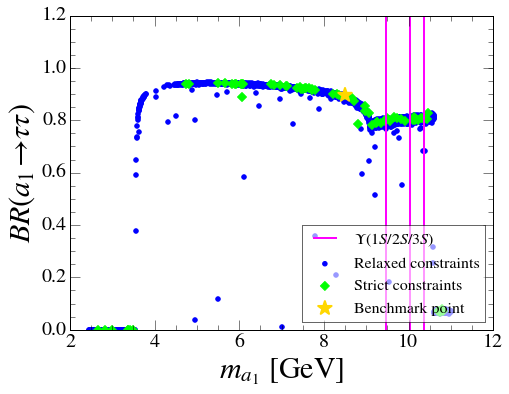

In [55]:
fig = generate_fig()
ax1 = fig.add_subplot(1,2,1)
xvar = 'ma1'
xlabel = r'$m_{a_1}\ \mathrm{[GeV]}$'
yvar = 'Bra1tautau'
ylabel = r'$BR(a_1\to\tau\tau)$'
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_h1, 
             color='blue', xlabel=xlabel, ylabel=ylabel, 
             label='Relaxed constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_strict, 
             color='lime', xlabel=xlabel, ylabel=ylabel, marker='D', s=40,
             label='Strict constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_ref, 
             xlabel=xlabel, ylabel=ylabel,
             label='Benchmark point', color='gold', marker="*", s=200, lw=2)
draw_res_lines()
plt.ylim(bottom=0)
plt.legend(fontsize=16, loc=4)

Now let's plot the observables against input parameters:

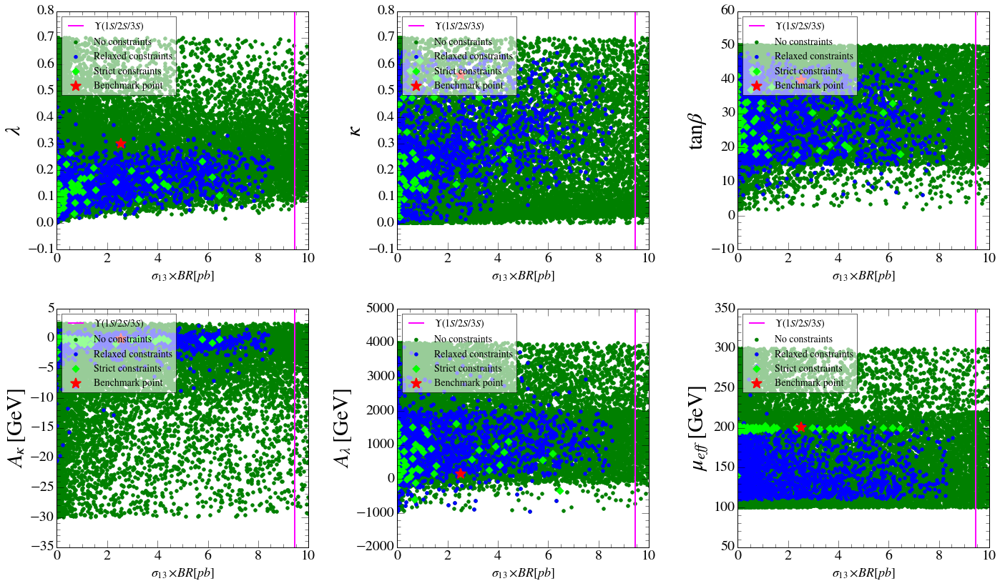

In [43]:
nrows = math.ceil(len(param_dict)/3.)
fig = generate_fig(size=[20,6*nrows])
xvar='xsec13_h1_2a1_4tau'
for i, (var, label) in enumerate(param_dict.iteritems(), 1):
    ax1 = fig.add_subplot(nrows,3,i)
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_orig, color='green', label='No constraints')
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_pass_all, color='blue', label='Relaxed constraints')
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_pass_all_strict, color='lime', label='Strict constraints', marker='D', s=50)    
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_ref, label='Benchmark point', color='red', marker="*", s=200, lw=2)    
    draw_res_lines()
    plt.xlim(left=0, right=10)
    plt.xlabel(r'$\sigma_{13} \times BR [pb]$', fontsize=18)
    plt.ylabel(label)
    plt.legend(fontsize=14, loc='best')

Log x axis version:

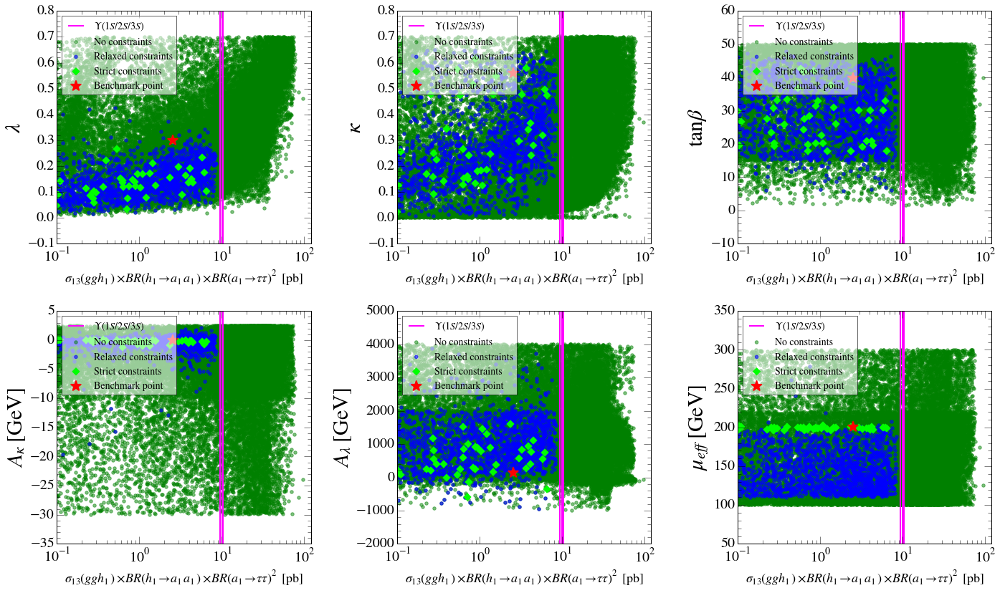

In [44]:
nrows = math.ceil(len(param_dict)/3.)
fig = generate_fig(size=[20,6*nrows])
xvar='xsec13_h1_2a1_4tau'
for i, (var, label) in enumerate(param_dict.iteritems(), 1):
    ax1 = fig.add_subplot(nrows,3,i)
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_orig, color='green', label='No constraints', alpha=0.5)
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_pass_all, color='blue', label='Relaxed constraints', alpha=0.6)
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_pass_all_strict, color='lime', label='Strict constraints', marker='D', s=50)    
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_ref, label='Benchmark point', color='red', marker="*", s=200, lw=2)    
    draw_res_lines()
    plt.legend(fontsize=14, loc='best')
    plt.xlim(left=0.1)
    plt.xlabel(r'$\sigma_{13}(ggh_1)\times BR(h_1\to a_1 a_1)\times BR(a_1\to\tau \tau)^2\ \mathrm{[pb]}$', fontsize=18)
    plt.ylabel(label)
    plt.xscale('log')

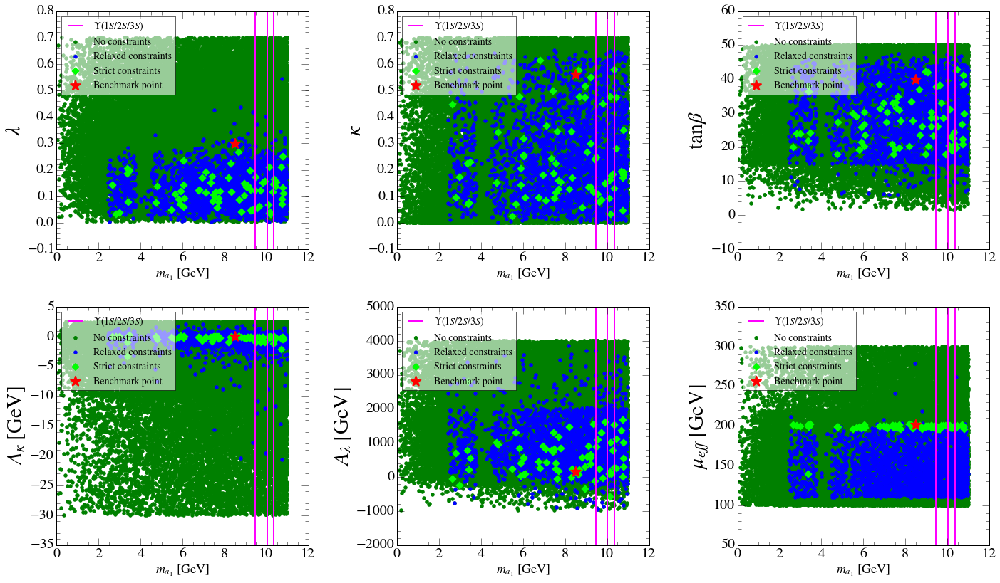

In [45]:
nrows = math.ceil(len(param_dict)/3.)
fig = generate_fig(size=[20,6*nrows])
xvar='ma1'
for i, (var, label) in enumerate(param_dict.iteritems(), 1):
    ax1 = fig.add_subplot(nrows,3,i)
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_orig, color='green', label='No constraints')
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_pass_all, color='blue', label='Relaxed constraints')
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_pass_all_strict, color='lime', label='Strict constraints', marker='D', s=50)    
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_ref, label='Benchmark point', color='red', marker="*", s=200, lw=2)    
    plt.xlim(left=0)
    plt.xlabel(r'$m_{a_1}\ \mathrm{[GeV]}$', fontsize=18)
    plt.ylabel(label)
    draw_res_lines()
    plt.legend(fontsize=14, loc='best')

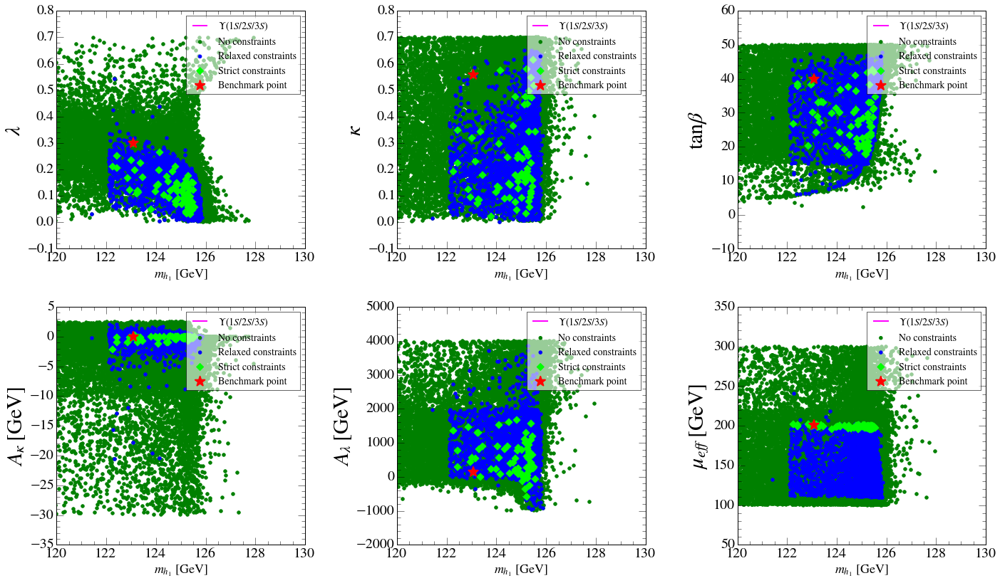

In [46]:
nrows = math.ceil(len(param_dict)/3.)
fig = generate_fig(size=[20,6*nrows])
xvar='mh1'
for i, (var, label) in enumerate(param_dict.iteritems(), 1):
    ax1 = fig.add_subplot(nrows,3,i)
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_orig, color='green', label='No constraints')
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_pass_all, color='blue', label='Relaxed constraints')
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_pass_all_strict, color='lime', label='Strict constraints', marker='D', s=50)    
    plot_scatter(ax1, xvar=xvar, yvar=var, df=df_ref, label='Benchmark point', color='red', marker="*", s=200, lw=2)    
    plt.xlim(left=120, right=130)
    plt.xlabel(r'$m_{h_1}\ \mathrm{[GeV]}$', fontsize=18)
    plt.ylabel(label)
    draw_res_lines()
    plt.legend(fontsize=14, loc='best')

Aside: why no points for $m_{a_1} \sim 4$ GeV? Look at constraints that points fail in that window:

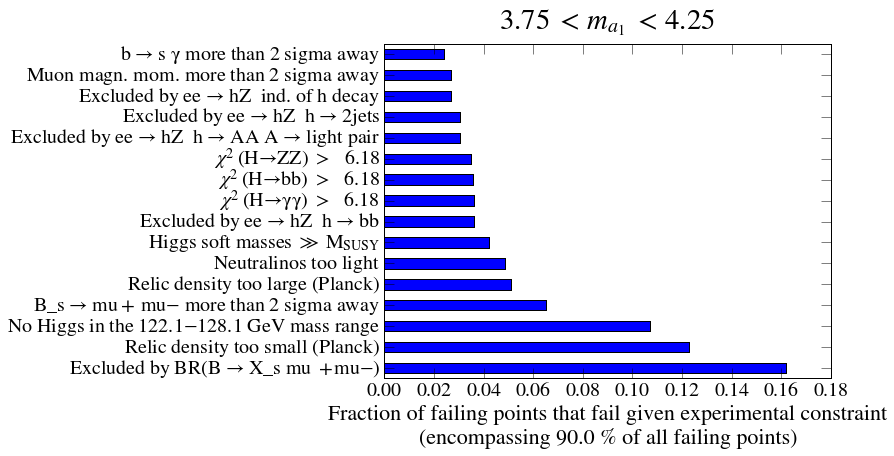

In [47]:
get_ipython().magic(u"config InlineBackend.figure_formats = ('pdf','png') ")
plot_constraints(df_orig[(df_orig.ma1<4.25) & (df_orig.ma1>3.75)], r"$3.75\ <\ m_{a_1}\ <\ 4.25$")

Let's compare it against points with a slightly lower adjacent mass windows and see the difference:

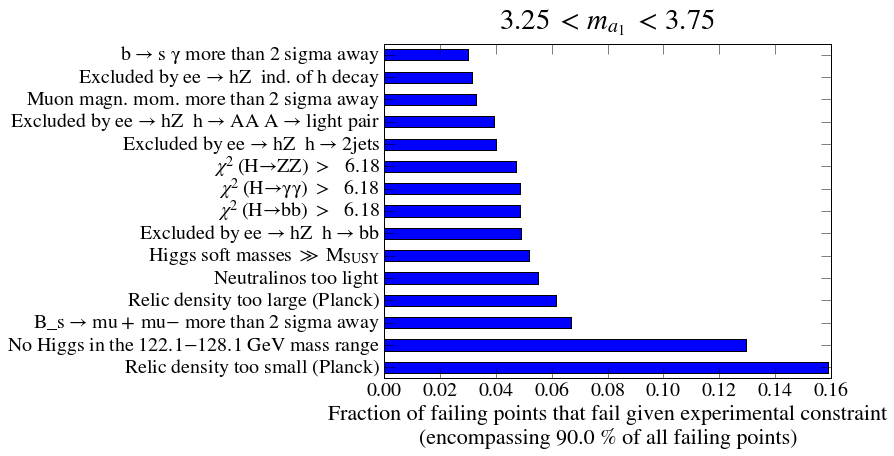

In [35]:
plot_constraints(df_orig[(df_orig.ma1<3.75) & (df_orig.ma1>3.25)], r"$3.25\ <\ m_{a_1}\ <\ 3.75$")

So clearly it is the $B \to X_s \mu\mu$ constraint that is causing this deficit of points interestingly

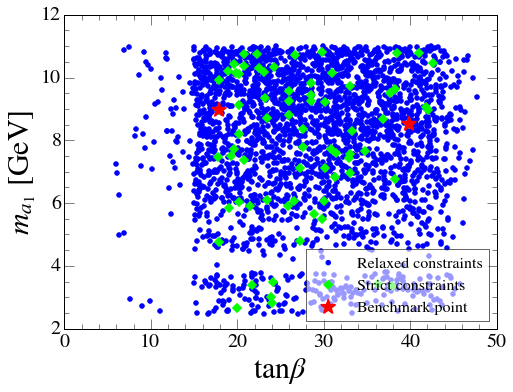

In [36]:
fig = generate_fig()
ax1 = fig.add_subplot(1,2,1)
xvar = 'tgbeta'
xlabel = r'$\tan\beta$'
ylabel = r'$m_{a_1}\ \mathrm{[GeV]}$'
yvar = 'ma1'
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_h1, 
             color='blue', xlabel=xlabel, ylabel=ylabel, 
             label='Relaxed constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_pass_all_strict, 
             color='lime', xlabel=xlabel, ylabel=ylabel, marker='D', s=40,
             label='Strict constraints')
plot_scatter(ax1, xvar=xvar, yvar=yvar, df=df_ref, 
             xlabel=xlabel, ylabel=ylabel,
             label='Benchmark point', color='red', marker="*", s=200, lw=2)
# plt.ylim(bottom=0)
plt.legend(fontsize=16, loc=4)